In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile
import os

zip_path = "/content/drive/MyDrive/archive.zip"
extract_dir = "/content/"

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print("Extraction complete!")

In [ ]:
import json
import os
from collections import defaultdict

with open('/content/ImageClassesCombinedWithCOCOAnnotations/coco_instances.json') as f:
    coco_data = json.load(f)

# for item in coco_data['categories']:
#     print(item['id'], item['name'])

images = coco_data['images']
images = sorted(images, key=lambda x: x['id'])

annotations = coco_data['annotations']
annotations = sorted(annotations, key=lambda x: x['image_id'])

# print(annotations)

image_id_to_annotations = defaultdict(list)
for ann in annotations:
    image_id_to_annotations[ann['image_id']].append(ann)

for image in images:
    image['annotations'] = image_id_to_annotations.get(image['id'], [])

# width and height are (300X300)

for image in images:
    del image['width']
    del image['height']
    del image['license']

for image in images:
  for annotation in image['annotations']:
    for category in coco_data['categories']:
        if annotation['category_id'] == category['id']:
            annotation['category_name'] = category['name']
    del annotation['category_id']
    del annotation['image_id']
    del annotation['id']
    del annotation['iscrowd']

# print(images)

print(images[2])

print("total: ", len(images))


In [ ]:
from collections import defaultdict
import copy
import matplotlib as plt

category_to_images = defaultdict(list)

for image in images:
    for annotation in image['annotations']:
        new_image = {
            'file_name': image['file_name'],
            'id': image['id'],
            'annotations': [copy.deepcopy(annotation)]
        }
        category_name = annotation['category_name']
        category_to_images[category_name].append(new_image)

def calcTotalInsects(category_to_images):
    total = 0
    for category, imgs in category_to_images.items():
        # print(f"{category}: {len(imgs)} images")
        total += len(imgs)

    return total

def visulaizeInsectsPerCategory(category_to_images):
  import matplotlib.pyplot as plt

  categories = list(category_to_images.keys())
  image_counts = [len(images) for images in category_to_images.values()]

  sorted_pairs = sorted(zip(categories, image_counts), key=lambda x: x[1])
  categories, image_counts = zip(*sorted_pairs)

  plt.figure(figsize=(12, 6))
  bars = plt.bar(categories, image_counts, color='lightgreen', edgecolor='black')

  for bar, count in zip(bars, image_counts):
      yval = bar.get_height()
      plt.text(bar.get_x() + bar.get_width()/2.0, yval + 50, str(count), ha='center', va='bottom', fontsize=9)

  plt.title('Image Count per Insect Category')
  plt.xlabel('Category')
  plt.ylabel('Number of Images')
  plt.xticks(rotation=45)
  plt.tight_layout()
  plt.grid(axis='y', linestyle='--', alpha=0.5)
  plt.show()


visulaizeInsectsPerCategory(category_to_images)
print("total: ", calcTotalInsects(category_to_images))


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

def show_annotated_image(image_data):
    file_path = os.path.join('/content/ImageClassesCombinedWithCOCOAnnotations/images_raw', image_data['file_name'])

    try:
        img = Image.open(file_path).convert("RGB")
    except FileNotFoundError:
        print(f"Image not found: {file_path}")
        return

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(img)

    for ann in image_data['annotations']:
        x, y, w, h = ann['bbox']
        rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(x, y - 5, ann['category_name'], color='white', backgroundcolor='red', fontsize=10)

    ax.axis('off')
    plt.show()

for key in category_to_images.keys():
    show_annotated_image(category_to_images[key][np.random.randint(0, len(category_to_images[key]))])



In [ ]:
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import os

from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os

def show_segmented_crop(image_data):
    # Use image_data['file_path'] if available, else use default path
    file_path = image_data.get('file_path', os.path.join(
        '/content/ImageClassesCombinedWithCOCOAnnotations/images_raw',
        image_data['file_name']
    ))

    try:
        img = Image.open(file_path).convert("RGB")
    except FileNotFoundError:
        print(f"Image not found: {file_path}")
        return

    if not image_data['annotations']:  # Check if there are no annotations
        # No annotations, just display the image as is
        plt.figure(figsize=(5, 5))
        plt.imshow(img)
        plt.title("Original Image (No Annotations)")
        plt.axis('off')
        plt.show()
        plt.close()
    else:
        # Loop through annotations and display segmented crop
        for ann in image_data['annotations']:
            mask = Image.new('L', img.size, 0)
            draw = ImageDraw.Draw(mask)

            if isinstance(ann['segmentation'], list):
                for seg in ann['segmentation']:
                    polygon = [(seg[i], seg[i + 1]) for i in range(0, len(seg), 2)]
                    draw.polygon(polygon, outline=1, fill=255)
            else:
                print(f"Unsupported segmentation format in image: {image_data['file_name']}")
                continue

            masked = Image.new('RGB', img.size)
            masked.paste(img, mask=mask)

            x, y, w, h = map(int, ann['bbox'])
            cropped = masked.crop((x, y, x + w, y + h))

            plt.figure(figsize=(3, 3))
            plt.imshow(cropped)
            plt.title(f"Segmented Crop: {ann['category_name']}")
            plt.axis('off')
            plt.show()
            plt.close()

for key in category_to_images.keys():
    show_segmented_crop(category_to_images[key][np.random.randint(0, len(category_to_images[key]))])

# print(category_to_images['ants'][np.random.randint(0, len(category_to_images['ants']))])


In [ ]:
print(category_to_images['grasshoppers'][np.random.randint(0, len(category_to_images['bees']))])

In [ ]:
def is_large_enough(annotation, min_area=1000, min_width=50, min_height=50):
    bbox = annotation['bbox']
    area = annotation['area']
    return (
        area >= min_area and
        bbox[2] >= min_width and
        bbox[3] >= min_height
    )

def is_connected_segmentation(segmentation, bbox, img_size=(300, 300)):
    import numpy as np
    from PIL import Image, ImageDraw
    from scipy.ndimage import label

    """
    segmentation: list of polygon coordinates (COCO-style).
    bbox: [x, y, w, h] for cropping mask area.
    img_size: size of full canvas (adjust to your dataset).
    """
    mask = Image.new('L', img_size, 0)
    draw = ImageDraw.Draw(mask)

    for polygon in segmentation:
        coords = list(zip(polygon[::2], polygon[::1][1::2]))
        draw.polygon(coords, outline=1, fill=1)

    x, y, w, h = map(int, bbox)
    cropped = mask.crop((x, y, x + w, y + h))
    mask_np = np.array(cropped)

    labeled, num_features = label(mask_np)
    return num_features == 1

filtered_images = {}

for key, img_list in category_to_images.items():
    filtered_images[key] = []
    for img_dict in img_list:
        annotation = img_dict['annotations'][0]
        if is_large_enough(annotation) and is_connected_segmentation(annotation['segmentation'], annotation['bbox']):
            filtered_images[key].append(img_dict)

# for key in filtered_images.keys():
#     show_segmented_crop(filtered_images[key][np.random.randint(0, len(filtered_images[key]))])

visulaizeInsectsPerCategory(filtered_images)
print("total: ", calcTotalInsects(filtered_images))


In [ ]:
for key in filtered_images.keys():
    show_segmented_crop(filtered_images[key][np.random.randint(0, len(filtered_images[key]))])

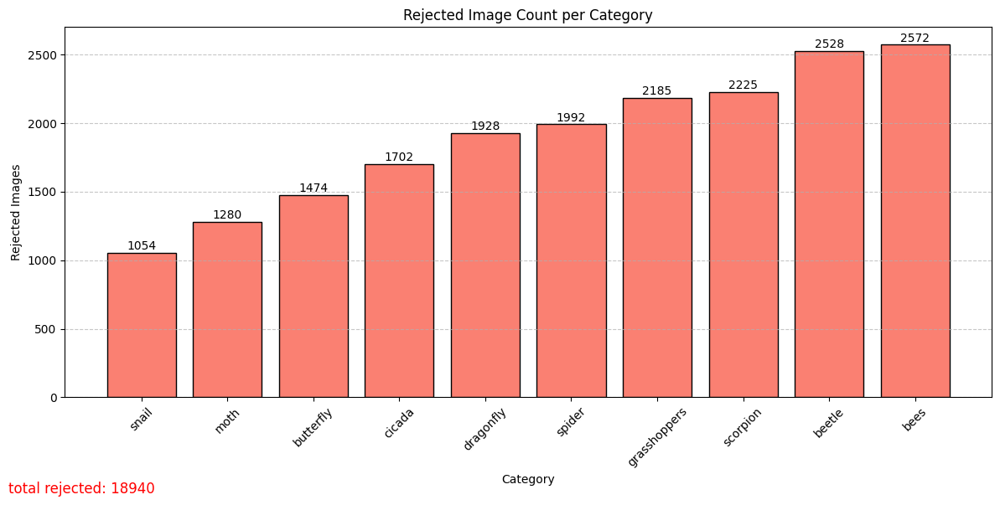

In [ ]:
import matplotlib.pyplot as plt

def plot_rejected_samples(original, filtered):
    rejected_data = [
        (cat, len(original[cat]) - len(filtered.get(cat, [])))
        for cat in original.keys()
    ]
    rejected_data.sort(key=lambda x: x[1])

    categories, rejected_counts = zip(*rejected_data)

    plt.figure(figsize=(12, 6))
    bars = plt.bar(categories, rejected_counts, color='salmon', edgecolor='black')
    plt.xlabel("Category")
    plt.ylabel("Rejected Images")
    plt.title("Rejected Image Count per Category")
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height + 5, f'{height}', ha='center', va='bottom')

    total_rejected = sum(rejected_counts)
    plt.figtext(0.01, 0.01, f'total rejected: {total_rejected}', fontsize=12, color='red')

    plt.tight_layout()
    plt.show()

plot_rejected_samples(category_to_images, filtered_images)

bees


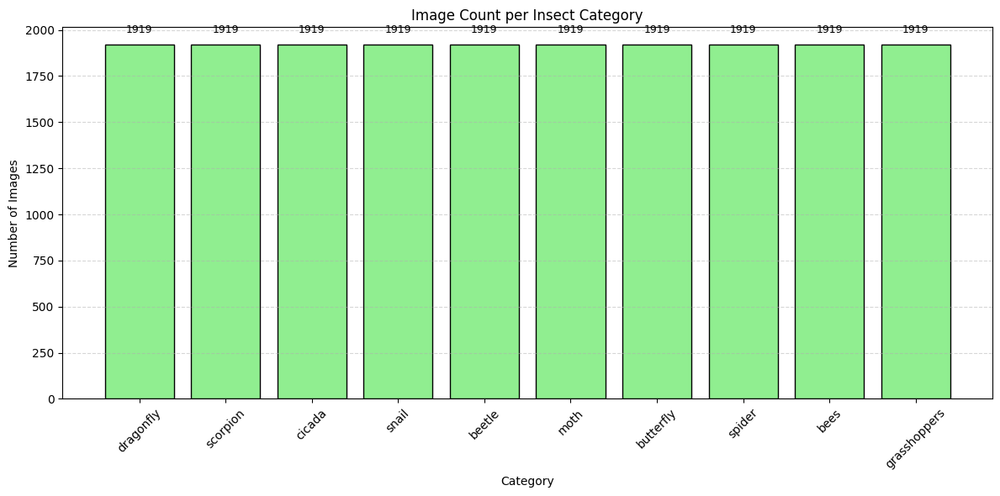

total:  19190


In [ ]:
def oversample_images(filtered_images):
    import random
    max_count = max(len(imgs) for imgs in filtered_images.values())
    balanced = {}
    for category, imgs in filtered_images.items():
        if len(imgs) < max_count:
            repeats = max_count // len(imgs)
            remainder = max_count % len(imgs)
            balanced[category] = imgs * repeats + random.sample(imgs, remainder)
        else:
            balanced[category] = imgs
    return balanced

print(filtered_images['bees'][0]['annotations'][0]['category_name'])

import os
import random

def oversample_with_new_images(filtered_images, insects_folder, starting_id=100000):
    max_count = max(len(imgs) for imgs in filtered_images.values())
    balanced = {}
    next_id = starting_id

    for class_name, imgs in filtered_images.items():
        current_count = len(imgs)
        needed = max_count - current_count

        # Capitalize or adjust class_name to match folder naming
        class_folder = imgs[0]['annotations'][0]['category_name'].capitalize()
        if class_folder == 'Bee':
            class_folder = 'Bees'
        elif class_folder == 'Beetle':
            class_folder = 'Beetles'
        elif class_folder == 'Grasshoppers':
            class_folder = 'Grasshopper'

        class_dir = os.path.join(insects_folder, class_folder)

        all_file_names = [
            f for f in os.listdir(class_dir)
            if f.lower().endswith(('.jpg', '.jpeg', '.png'))
        ]

        used_file_names = set(img['file_name'] for img in imgs)
        candidates = [f for f in all_file_names if f not in used_file_names]

        if len(candidates) < needed:
            # Use repetition if not enough unique files
            additional_files = random.choices(all_file_names, k=needed)
        else:
            additional_files = random.sample(candidates, needed)

        new_image_entries = []
        for fname in additional_files:
            new_image_entries.append({
                'file_name': fname,
                'id': next_id,
                'annotations': [],
                'file_path': os.path.join(class_dir, fname)
            })
            next_id += 1

        balanced[class_name] = imgs + new_image_entries

    return balanced

balanced_images = oversample_with_new_images(filtered_images, '/content/Insect Classes/Insect Classes/', 1)
visulaizeInsectsPerCategory(balanced_images)
print("total: ", calcTotalInsects(balanced_images))

1919


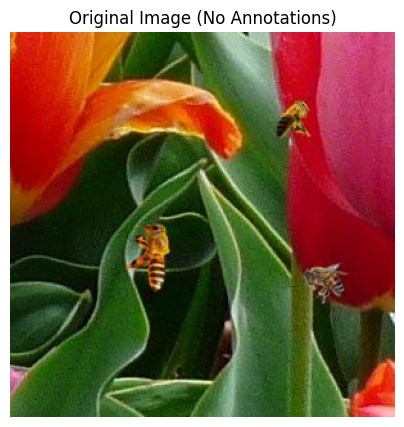

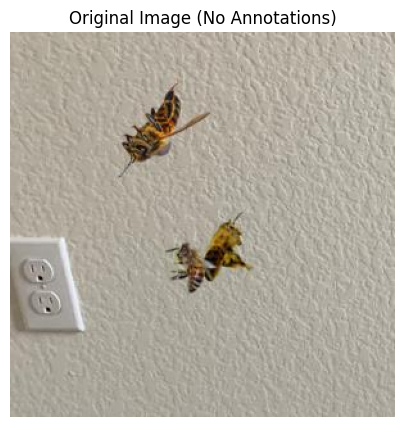

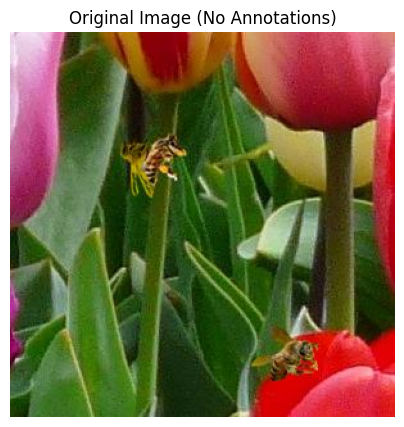

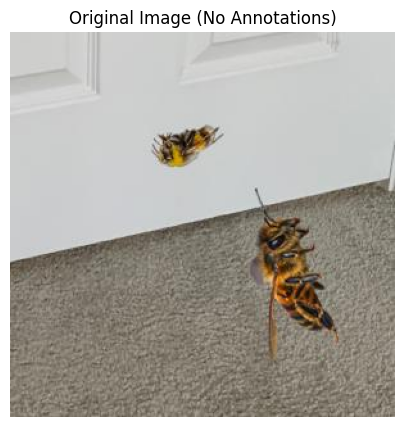

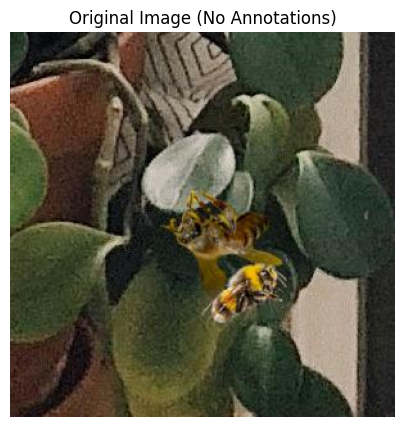

...

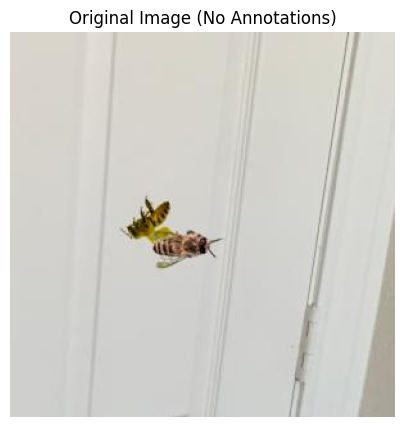

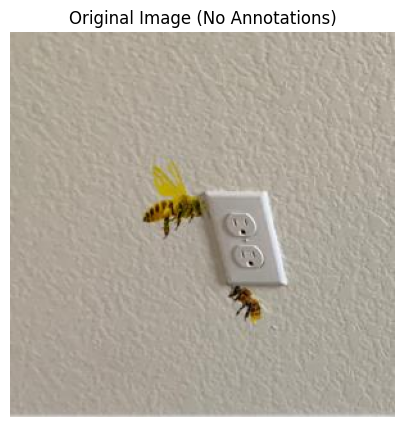

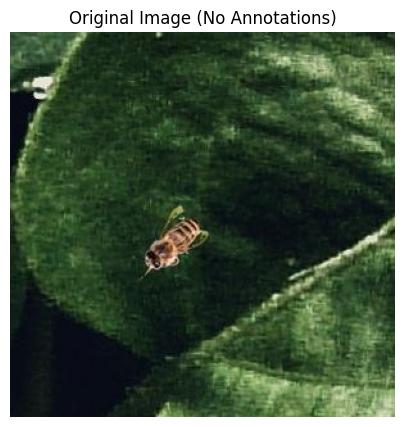

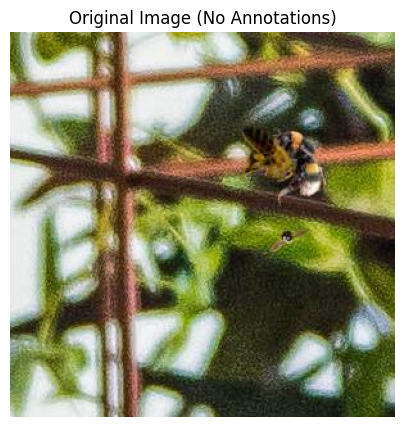

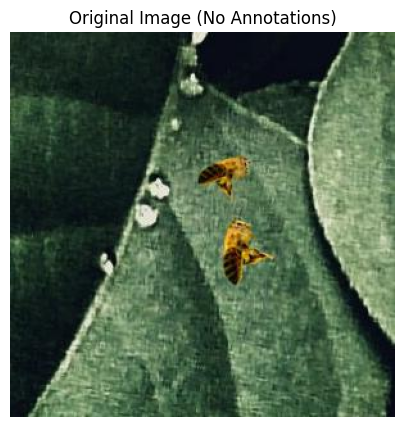

In [ ]:
# for key in filtered_images.keys():
#     show_segmented_crop(balanced_images[key][np.random.randint(0, len(filtered_images[key]))])

print(len(balanced_images['bees']))

for i in range(500, 550):
    show_segmented_crop(balanced_images['bees'][i])

In [ ]:
import os
from PIL import Image, ImageDraw
import numpy as np

def resize_with_padding(image, target_size):
    width, height = image.size
    target_width, target_height = target_size

    scale = min(target_width / width, target_height / height)

    new_width = int(width * scale)
    new_height = int(height * scale)

    resized_image = image.resize((new_width, new_height), Image.Resampling.LANCZOS)

    new_image = Image.new("RGB", target_size, (0, 0, 0))
    new_image.paste(resized_image, ((target_width - new_width) // 2, (target_height - new_height) // 2))

    return new_image

def save_segmented_images(balanced_images, base_path, output_dir, img_size=(224, 224)):
    os.makedirs(output_dir, exist_ok=True)

    for class_name, entries in balanced_images.items():
        class_dir = os.path.join(output_dir, class_name)
        os.makedirs(class_dir, exist_ok=True)

        for idx, entry in enumerate(entries):
            try:
                file_path = entry.get('file_path', os.path.join(base_path, entry['file_name']))
                img = Image.open(file_path).convert('RGB')

                # Check if annotations are present
                if not entry['annotations']:
                    # If no annotations, save the image as is
                    resized_img = resize_with_padding(img, img_size)
                    save_name = f"{os.path.splitext(entry['file_name'])[0]}_{idx}.jpg"
                    save_path = os.path.join(class_dir, save_name)
                    resized_img.save(save_path)
                    print(f"Saved {save_name} (no annotations)")
                else:
                    # Process with annotations
                    annotation = entry['annotations'][0]
                    segmentation = annotation['segmentation'][0]

                    mask_img = Image.new('L', img.size, 0)
                    polygon = [(segmentation[i], segmentation[i + 1]) for i in range(0, len(segmentation), 2)]
                    ImageDraw.Draw(mask_img).polygon(polygon, outline=1, fill=1)

                    mask = np.array(mask_img)
                    img_array = np.array(img)
                    masked_img_array = img_array * mask[:, :, np.newaxis]

                    ys, xs = np.where(mask)
                    if len(xs) == 0 or len(ys) == 0:
                        print(f"Empty mask for {entry['file_name']}, skipping...")
                        continue

                    x_min, x_max = xs.min(), xs.max()
                    y_min, y_max = ys.min(), ys.max()
                    cropped = masked_img_array[y_min:y_max+1, x_min:x_max+1]

                    cropped_img = Image.fromarray(cropped)
                    resized_img = resize_with_padding(cropped_img, img_size)

                    save_name = f"{os.path.splitext(entry['file_name'])[0]}_{idx}.jpg"
                    save_path = os.path.join(class_dir, save_name)
                    resized_img.save(save_path)

                    print(f"Saved {save_name}")

            except Exception as e:
                print(f"Error processing {entry['file_name']}: {e}")

base_path = "/content/ImageClassesCombinedWithCOCOAnnotations/images_raw"
output_dir = "/content/SegmentedDataset"
save_segmented_images(balanced_images, base_path, output_dir)

Streaming output truncated to the last 5000 lines.
Saved 00011158_757.jpg
Saved 00011183_758.jpg
Saved 00011183_759.jpg
Saved 00011188_760.jpg
Saved 00011211_761.jpg
Saved 00011216_762.jpg
Saved 00011226_763.jpg
Saved 00011245_764.jpg
Saved 00011247_765.jpg
Saved 00011249_766.jpg
Saved 00011269_767.jpg
Saved 00011292_768.jpg
Saved 00011305_769.jpg
Saved 00011316_770.jpg
Saved 00011317_771.jpg
Saved 00011374_772.jpg
Saved 00011386_773.jpg
Saved 00011391_774.jpg
Saved 00011416_775.jpg
Saved 00011418_776.jpg
Saved 00011506_777.jpg
Saved 00011507_778.jpg
Saved 00011508_779.jpg
Saved 00011509_780.jpg
Saved 00011510_781.jpg
Saved 00011516_782.jpg
Saved 00011544_783.jpg
Saved 00011556_784.jpg
Saved 00011557_785.jpg
Saved 00011585_786.jpg
Saved 00011636_787.jpg
Saved 00011643_788.jpg
Saved 00011698_789.jpg
Saved 00011712_790.jpg
Saved 00011718_791.jpg
Saved 00011719_792.jpg
Saved 00011743_793.jpg
Saved 00011751_794.jpg
Saved 00011762_795.jpg
Saved 00011781_796.jpg
Saved 00011782_797.jpg
Saved 

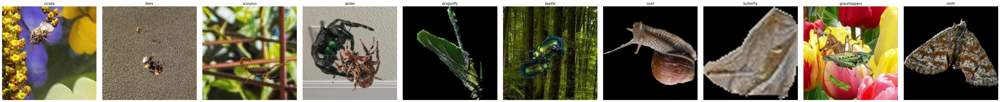

In [ ]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

def show_random_images_from_each_class(segmented_dataset_path):
    class_dirs = [d for d in os.listdir(segmented_dataset_path)
                  if os.path.isdir(os.path.join(segmented_dataset_path, d))]

    num_classes = len(class_dirs)
    fig, axs = plt.subplots(1, num_classes, figsize=(5 * num_classes, 5))

    if num_classes == 1:
        axs = [axs]

    for i, class_name in enumerate(class_dirs):
        class_path = os.path.join(segmented_dataset_path, class_name)
        images = os.listdir(class_path)
        if not images:
            print(f"No images in {class_name}")
            continue

        img_name = random.choice(images)
        img_path = os.path.join(class_path, img_name)

        try:
            img = Image.open(img_path)
            axs[i].imshow(img)
            axs[i].axis('off')
            axs[i].set_title(class_name)
        except Exception as e:
            print(f"Failed to load {img_path}: {e}")

    plt.tight_layout()
    plt.show()

segmented_dataset_path = "/content/SegmentedDataset"
show_random_images_from_each_class(segmented_dataset_path)

Found 13430 images belonging to 10 classes.
Found 2870 images belonging to 10 classes.
Found 2890 images belonging to 10 classes.
Class weights: {0: 1.0, 1: 1.0, 2: 1.0, 3: 1.0, 4: 1.0, 5: 1.0, 6: 1.0, 7: 1.0, 8: 1.0, 9: 1.0}
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/5


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


420/420 ━━━━━━━━━━━━━━━━━━━━ 42s 73ms/step - accuracy: 0.7184 - loss: 0.8720 - val_accuracy: 0.8620 - val_loss: 0.4065
Epoch 2/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 22s 52ms/step - accuracy: 0.8954 - loss: 0.3153 - val_accuracy: 0.8941 - val_loss: 0.3318
Epoch 3/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 24s 57ms/step - accuracy: 0.9318 - loss: 0.2158 - val_accuracy: 0.8983 - val_loss: 0.3311
Epoch 4/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 39s 52ms/step - accuracy: 0.9486 - loss: 0.1583 - val_accuracy: 0.9017 - val_loss: 0.3522
Epoch 5/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 22s 51ms/step - accuracy: 0.9623 - loss: 0.1210 - val_accuracy: 0.9052 - val_loss: 0.3149
91/91 ━━━━━━━━━━━━━━━━━━━━ 7s 82ms/step - accuracy: 0.8975 - loss: 0.3523
🧪 Test accuracy: 0.9017
🧪 Test loss:     0.3449


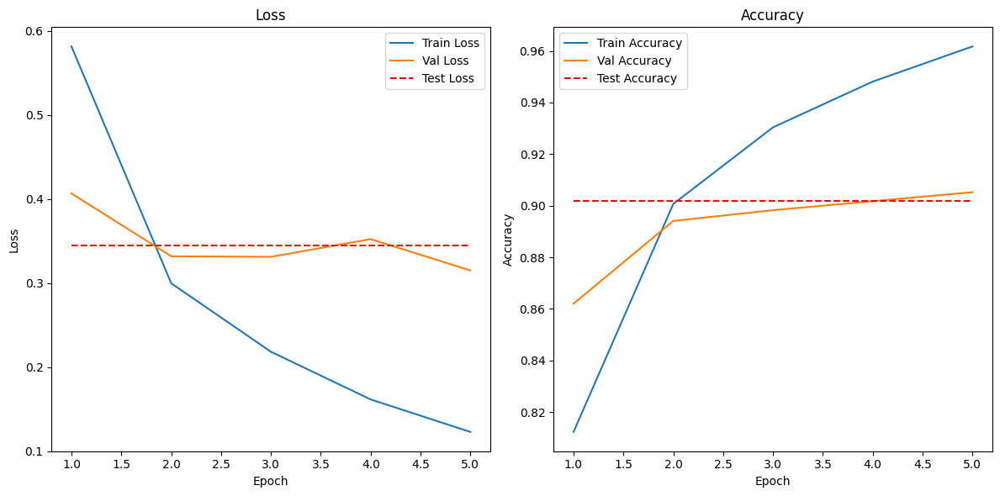

Model saved as 'insect_classifier_model_mobilenet.h5'


In [ ]:
import os
import numpy as np
import tensorflow as tf
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
import matplotlib.pyplot as plt
import shutil

# Paths
original_dir = '/content/SegmentedDataset'
base_dir = '/content/SegmentedDataset_Split'
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'val')
test_dir = os.path.join(base_dir, 'test')

# Create split dirs
def split_dataset(original_dir, base_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    if os.path.exists(base_dir):
        shutil.rmtree(base_dir)
    os.makedirs(train_dir)
    os.makedirs(val_dir)
    os.makedirs(test_dir)

    for class_name in os.listdir(original_dir):
        class_path = os.path.join(original_dir, class_name)
        images = os.listdir(class_path)

        np.random.shuffle(images)
        total = len(images)
        train_end = int(train_ratio * total)
        val_end = train_end + int(val_ratio * total)

        splits = {
            'train': images[:train_end],
            'val': images[train_end:val_end],
            'test': images[val_end:]
        }

        for split, split_images in splits.items():
            split_class_dir = os.path.join(base_dir, split, class_name)
            os.makedirs(split_class_dir)
            for img_name in split_images:
                src = os.path.join(class_path, img_name)
                dst = os.path.join(split_class_dir, img_name)
                shutil.copy(src, dst)

# Perform the split
split_dataset(original_dir, base_dir)

# Data generators
img_size = (224, 224)
batch_size = 32

train_datagen = ImageDataGenerator(rescale=1./255)
val_test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True
)

val_generator = val_test_datagen.flow_from_directory(
    val_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

test_generator = val_test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Compute class weights on training set
class_weights_array = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)
class_weights = dict(enumerate(class_weights_array))
print("Class weights:", class_weights)

# Define MobileNetV2 model
base_model = tf.keras.applications.MobileNetV2(
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(len(train_generator.class_indices), activation='softmax')
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=5,
    class_weight=class_weights
)

# Plotting
def plot_loss_curves(history, test_loss, test_acc):
    epochs = range(1, len(history.history['loss']) + 1)

    plt.figure(figsize=(12, 6))

    # Plot Loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history.history['loss'], label='Train Loss')
    plt.plot(epochs, history.history['val_loss'], label='Val Loss')
    plt.hlines(test_loss, xmin=1, xmax=len(epochs), colors='red', linestyles='dashed', label='Test Loss')
    plt.title('Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    # Plot Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history.history['accuracy'], label='Train Accuracy')
    plt.plot(epochs, history.history['val_accuracy'], label='Val Accuracy')
    plt.hlines(test_acc, xmin=1, xmax=len(epochs), colors='red', linestyles='dashed', label='Test Accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

test_loss, test_acc = model.evaluate(test_generator, verbose=1)
print(f"🧪 Test accuracy: {test_acc:.4f}")
print(f"🧪 Test loss:     {test_loss:.4f}")

plot_loss_curves(history, test_loss, test_acc)

# Save model
model.save("insect_classifier_model_mobilenet.h5")
print("Model saved as 'insect_classifier_model_mobilenet.h5'")


Testing on image: /content/SegmentedDataset/bees/00002114_56.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


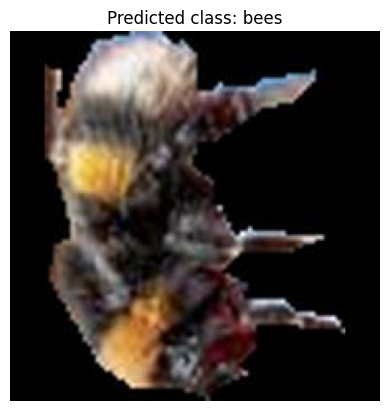

Predicted class for the test image: bees


In [ ]:
import os
import numpy as np
import random
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from PIL import Image
import matplotlib.pyplot as plt

# Path to the SegmentedDataset and the saved model
segmented_data_dir = '/content/SegmentedDataset'
model_path = 'insect_classifier_model_mobilenet.h5'

# Load the saved model
model = load_model(model_path)

# Function to get a random image from the SegmentedDataset
def get_random_image_from_dataset(dataset_dir):
    # Get all the class directories (subfolders)
    class_dirs = [os.path.join(dataset_dir, class_name) for class_name in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, class_name))]

    # Randomly pick a class
    random_class_dir = random.choice(class_dirs)

    # Get all image files in the selected class
    image_files = [f for f in os.listdir(random_class_dir) if f.endswith('.jpg') or f.endswith('.jpeg') or f.endswith('.png')]

    # Randomly pick an image file
    random_image_file = random.choice(image_files)

    # Full path to the randomly selected image
    random_image_path = os.path.join(random_class_dir, random_image_file)

    return random_image_path

# Function to preprocess the image
def preprocess_image(image_path, target_size=(224, 224)):
    img = Image.open(image_path).convert("RGB")  # Load image in RGB format
    img = img.resize(target_size)  # Resize image to the input size expected by the model
    img_array = np.array(img) / 255.0  # Normalize image to [0, 1] range
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    return img_array

# Load a random image from the SegmentedDataset
random_image_path = get_random_image_from_dataset(segmented_data_dir)
print(f"Testing on image: {random_image_path}")

# Preprocess the image
img_array = preprocess_image(random_image_path)

# Make a prediction
prediction = model.predict(img_array)
predicted_label_index = np.argmax(prediction)
class_names = sorted(os.listdir(segmented_data_dir))  # Load class names based on subfolder names
predicted_class = class_names[predicted_label_index]

# Display the image along with the predicted class
img = Image.open(random_image_path)
plt.imshow(img)
plt.title(f"Predicted class: {predicted_class}")
plt.axis('off')
plt.show()

print(f"Predicted class for the test image: {predicted_class}")

91/91 ━━━━━━━━━━━━━━━━━━━━ 11s 84ms/step


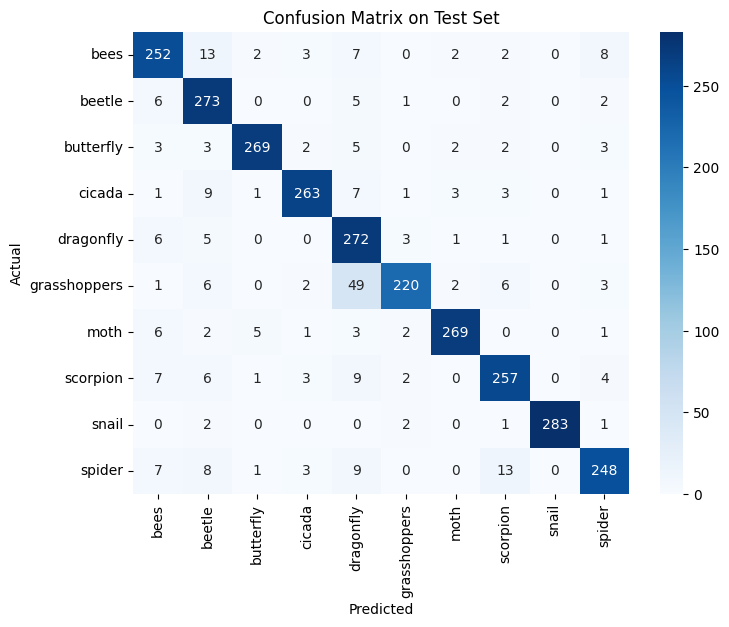

In [ ]:
# Generating confusion matrix to see where we are atm
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# 1) Get predictions (softmax scores → class indices)
y_pred_probs  = model.predict(test_generator, verbose=1)
y_pred_labels = np.argmax(y_pred_probs, axis=1)

# 2) True labels
y_true = test_generator.classes

# 3) Confusion matrix
cm = confusion_matrix(y_true, y_pred_labels)

# 4) Plot
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d',
            xticklabels=test_generator.class_indices.keys(),
            yticklabels=test_generator.class_indices.keys(),
            cmap='Blues')
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix on Test Set")
plt.show()


In [ ]:
pip install gradio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.1/54.1 MB 15.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.9/322.9 kB 30.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.2/95.2 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.5/11.5 MB 95.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 6.2 MB/s eta 0:00:00


In [ ]:
import os, numpy as np, random
import tensorflow as tf
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
import gradio as gr

# image size & batch
IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# Path to your segmented dataset
DATA_DIR = '/content/SegmentedDataset'
# Normalize and split the dataset
datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2  # 80% train, 20% test
)

train_gen = datagen.flow_from_directory(
    DATA_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    shuffle=True
)

test_gen = datagen.flow_from_directory(
    DATA_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    shuffle=False
)

class_names = list(train_gen.class_indices.keys())
NUM_CLASSES = len(class_names)
print(f"Classes ({NUM_CLASSES}):", class_names)


Found 15360 images belonging to 10 classes.
Found 3830 images belonging to 10 classes.
Classes (10): ['bees', 'beetle', 'butterfly', 'cicada', 'dragonfly', 'grasshoppers', 'moth', 'scorpion', 'snail', 'spider']


In [ ]:
def build_compile_model(base_fn):
    base = base_fn(
        weights='imagenet', include_top=False,
        input_shape=(*IMG_SIZE, 3)
    )
    base.trainable = False

    model = tf.keras.Sequential([
        base,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dense(NUM_CLASSES, activation='softmax'),
    ])

    model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    return model

def train_and_evaluate(model, name, epochs=5):
    print(f"\n▶️ Training {name}")
    model.fit(train_gen, epochs=epochs, validation_data=test_gen)

    print(f"\n▶️ Evaluating {name}")
    loss, acc = model.evaluate(test_gen, verbose=0)
    print(f"{name} — Test accuracy: {acc:.4f}")

    # Confusion matrix
    y_pred = model.predict(test_gen, verbose=0)
    y_pred_labels = np.argmax(y_pred, axis=1)
    y_true = test_gen.classes

    cm = confusion_matrix(y_true, y_pred_labels)
    plt.figure(figsize=(6,5))
    sns.heatmap(cm, annot=True, fmt='d',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title(f"{name} Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

    return acc, cm



▶️ Training MobileNetV2
Epoch 1/4


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


480/480 ━━━━━━━━━━━━━━━━━━━━ 36s 62ms/step - accuracy: 0.7811 - loss: 0.6681 - val_accuracy: 0.7201 - val_loss: 1.0255
Epoch 2/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 28s 59ms/step - accuracy: 0.9353 - loss: 0.2051 - val_accuracy: 0.7366 - val_loss: 1.0272
Epoch 3/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 25s 53ms/step - accuracy: 0.9566 - loss: 0.1448 - val_accuracy: 0.7352 - val_loss: 0.9964
Epoch 4/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 27s 57ms/step - accuracy: 0.9711 - loss: 0.0952 - val_accuracy: 0.7295 - val_loss: 1.2326

▶️ Evaluating MobileNetV2
MobileNetV2 — Test accuracy: 0.7295


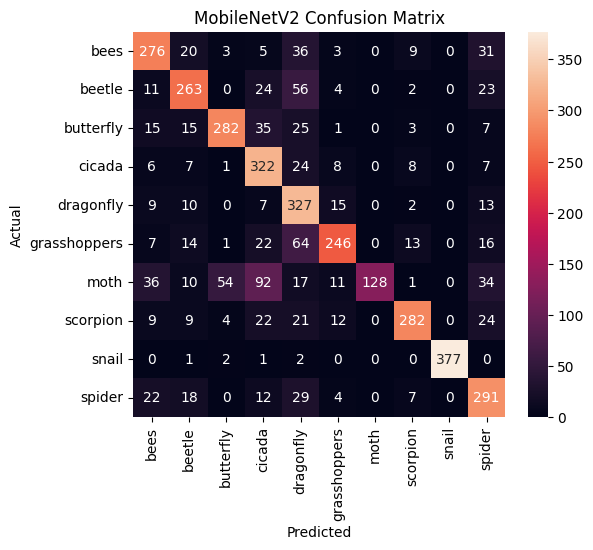

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

▶️ Training EfficientNetB0
Epoch 1/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 55s 75ms/step - accuracy: 0.1015 - loss: 2.3190 - val_accuracy: 0.1000 - val_loss: 2.3026
Epoch 2/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 25s 53ms/step - accuracy: 0.0992 - loss: 2.3027 - val_accuracy: 0.1000 - val_loss: 2.3026
Epoch 3/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 42s 55ms/step - accuracy: 0.1022 - loss: 2.3026 - val_accuracy: 0.1000 - val_loss: 2.3026
Epoch 4/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 26s 54ms/step - accuracy: 0.0963 - loss: 2.3028 - val_accuracy: 0.1000 - val_loss: 2.3026

▶️ Evaluating EfficientNetB0
EfficientNetB0 — Test accuracy: 0.1000


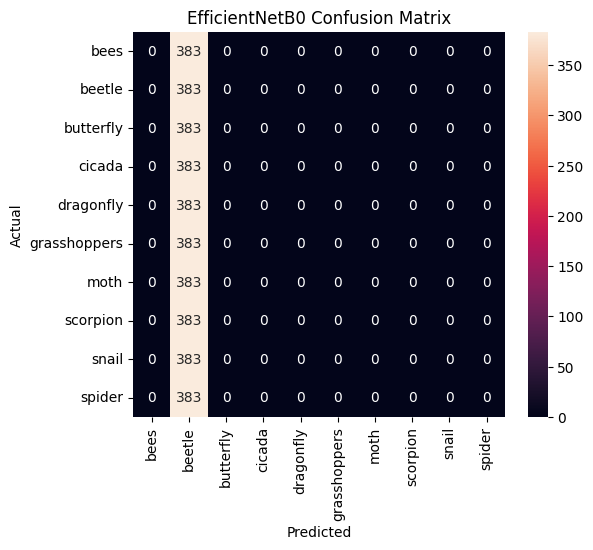

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

▶️ Training ResNet50
Epoch 1/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 73s 126ms/step - accuracy: 0.1472 - loss: 2.2785 - val_accuracy: 0.1731 - val_loss: 2.2620
Epoch 2/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 52s 109ms/step - accuracy: 0.2334 - loss: 2.0939 - val_accuracy: 0.1869 - val_loss: 2.3131
Epoch 3/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 53s 110ms/step - accuracy: 0.2656 - loss: 2.0144 - val_accuracy: 0.2110 - val_loss: 2.3031
Epoch 4/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 53s 110ms/step - accuracy: 0.3020 - loss: 1.9539 - val_accuracy: 0.2352 - val_loss: 2.2495

▶️ Evaluating ResNet50
ResNet50 — Test accuracy: 0.2352


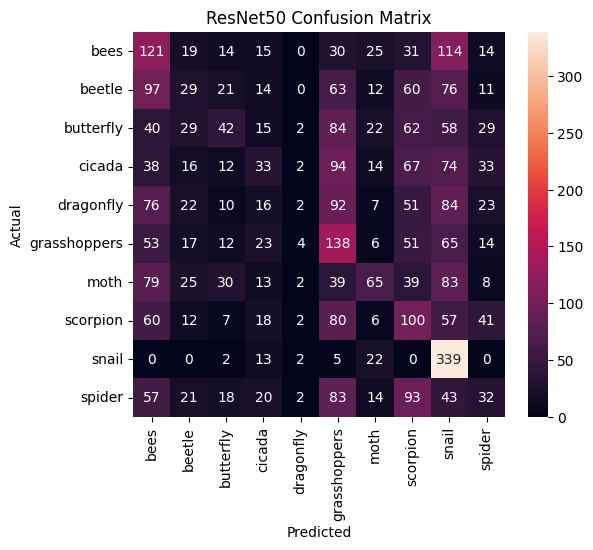


▶️ Summary of test accuracies:
 • MobileNetV2: 72.95%
 • EfficientNetB0: 10.00%
 • ResNet50: 23.52%


In [ ]:
from tensorflow.keras.applications import MobileNetV2, EfficientNetB0, ResNet50

results = {}
for fn, label in [(MobileNetV2, 'MobileNetV2'),
                  (EfficientNetB0, 'EfficientNetB0'),
                  (ResNet50, 'ResNet50')]:
    m = build_compile_model(fn)
    acc, cm = train_and_evaluate(m, label, epochs=4)
    results[label] = {'accuracy': acc, 'confusion_matrix': cm}

# Summarize
print("\n▶️ Summary of test accuracies:")
for name, info in results.items():
    print(f" • {name}: {info['accuracy']:.2%}")


In [ ]:
# Choose the model with highest accuracy
best_name = max(results, key=lambda k: results[k]['accuracy'])
print("🏆 Best model:", best_name)

# Rebuild, retrain (or load weights) and save
best_fn = {
    'MobileNetV2': MobileNetV2,
    'EfficientNetB0': EfficientNetB0,
    'ResNet50': ResNet50
}[best_name]

best_model = build_compile_model(best_fn)
best_model.fit(train_gen, epochs=4, validation_data=test_gen)
best_model.save(f"{best_name}_insect_classifier.h5")
print(f"Saved {best_name}_insect_classifier.h5")


🏆 Best model: MobileNetV2
Epoch 1/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 36s 60ms/step - accuracy: 0.7788 - loss: 0.6844 - val_accuracy: 0.7081 - val_loss: 1.0675
Epoch 2/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 24s 50ms/step - accuracy: 0.9304 - loss: 0.2217 - val_accuracy: 0.7441 - val_loss: 0.9327
Epoch 3/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 26s 54ms/step - accuracy: 0.9502 - loss: 0.1488 - val_accuracy: 0.7151 - val_loss: 1.1963
Epoch 4/4
480/480 ━━━━━━━━━━━━━━━━━━━━ 26s 55ms/step - accuracy: 0.9676 - loss: 0.1012 - val_accuracy: 0.7235 - val_loss: 1.2157


Saved MobileNetV2_insect_classifier.h5


In [ ]:
def predict_image(img_path, model):
    img = load_img(img_path, target_size=IMG_SIZE)
    arr = img_to_array(img) / 255.0
    arr = np.expand_dims(arr, 0)
    preds = model.predict(arr)[0]
    idx = np.argmax(preds)
    return class_names[idx], float(preds[idx])


In [ ]:
import gradio as gr
import numpy as np
from PIL import Image
from tensorflow.keras.models import load_model

# Constants
IMG_SIZE = (224, 224)

# Load model
model = load_model("insect_classifier_model_mobilenet.h5")

# Define class names
class_names = ['bees', 'beetle', 'butterfly', 'cicada', 'dragonfly',
               'grasshoppers', 'moth', 'scorpion', 'snail', 'spider']
NUM_CLASSES = len(class_names)

# Classification function
def classify_image(image):
    image = image.resize(IMG_SIZE).convert("RGB")
    arr = np.array(image) / 255.0
    arr = np.expand_dims(arr, 0)
    preds = model.predict(arr)[0]
    return {class_names[i]: float(preds[i]) for i in range(NUM_CLASSES)}

# Gradio interface
iface = gr.Interface(
    fn=classify_image,
    inputs=gr.Image(type="pil"),
    outputs=gr.Label(num_top_classes=3),
    title="🦋 Insect Classifier",
    description="Upload an insect image to see the top-3 predicted classes.",
)

iface.launch(debug=True)

It looks like you are running Gradio on a hosted a Jupyter notebook. For the Gradio app to work, sharing must be enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://33343ac3ae73cdba52.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7861 <> https://33343ac3ae73cdba52.gradio.live


In [ ]:
# Now i am working on using existing segmentation technique to identify the insects clearly
# Colab Cell 2 — Load model & build file list
MODEL_PATH = "/content/insect_classifier_model_mobilenet.h5"
model = tf.keras.models.load_model(MODEL_PATH, compile=False)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Roots
RAW_ROOT       = "/content/ImageClassesCombinedWithCOCOAnnotations/images_raw"
SEGMENT_ROOT   = "/content/SegmentedDataset"

# Gather all segmented crop paths and map back to original
entries = []
for cls in os.listdir(SEGMENT_ROOT):
    cls_dir = os.path.join(SEGMENT_ROOT, cls)
    if not os.path.isdir(cls_dir): continue
    for fname in os.listdir(cls_dir):
        if not fname.lower().endswith(('.jpg','jpeg','png')): continue
        seg_path = os.path.join(cls_dir, fname)
        # Original filename before "_idx.jpg"
        orig = fname.rsplit('_', 1)[0] + os.path.splitext(fname)[1]
        raw_path = os.path.join(RAW_ROOT, orig)
        entries.append({
            "label": f"{cls}/{fname}",
            "seg_path": seg_path,
            "raw_path": raw_path,
            "bbox": None  # we'll look it up next
        })

# Load COCO annotations into a lookup for bboxes
import json
from collections import defaultdict
with open("/content/ImageClassesCombinedWithCOCOAnnotations/coco_instances.json") as f:
    coco = json.load(f)
ann_by_img = defaultdict(list)
for ann in coco['annotations']:
    ann_by_img[ann['image_id']].append(ann)
# map filenames→image_id
id_by_file = {img['file_name']: img['id'] for img in coco['images']}

# Fill bbox in each entry
for e in entries:
    fname = os.path.basename(e['raw_path'])
    img_id = id_by_file.get(fname)
    if img_id:
        # pick the first ann (should correspond to this segment crop)
        anns = ann_by_img[img_id]
        if anns: e['bbox'] = anns[0]['bbox']


In [ ]:
# Colab Cell 3 — Single-entry display + classify
def show_and_classify(choice):
    """
    choice: string like "bees/IMG_123_0.jpg"
    """
    e = next(item for item in entries if item['label']==choice)
    # 1) Raw with bbox
    raw = Image.open(e['raw_path']).convert("RGB")
    x,y,w,h = map(int, e['bbox'])
    draw = ImageDraw.Draw(raw)
    draw.rectangle([x,y,x+w,y+h], outline="red", width=3)

    # 2) Segmented crop
    seg = Image.open(e['seg_path']).convert("RGB").resize((224,224))

    # 3) Predict
    arr = np.array(seg)/255.0
    arr = np.expand_dims(arr,0)
    probs = model.predict(arr)[0]
    idx   = np.argmax(probs)
    classes = sorted(os.listdir(SEGMENT_ROOT))
    pred_label = classes[idx]
    conf = probs[idx]

    return raw, seg, f"{pred_label} ({conf:.2%})"


In [ ]:
# Colab Cell 4 — Launch Gradio UI
iface = gr.Interface(
    fn=show_and_classify,
    inputs=gr.Dropdown(
        choices=[e['label'] for e in entries],
        label="Choose segmented image"
    ),
    outputs=[
        gr.Image(type="pil", label="Raw image with bbox"),
        gr.Image(type="pil", label="Segmented crop (224×224)"),
        gr.Textbox(label="Prediction")
    ],
    title="Browse & Classify Segmented Insects",
    description=(
        "Select any crop from your SegmentedDataset.\n"
        "Left: raw image with the COCO bbox in red.\n"
        "Middle: the 224×224 crop you trained on.\n"
        "Right: model’s predicted class + confidence."
    )
)

iface.launch()


It looks like you are running Gradio on a hosted a Jupyter notebook. For the Gradio app to work, sharing must be enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://4fdd83e28185ef37a6.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


In [ ]:
# since multiple images not working now i am working on for multiple images using coco annotations
# Wish me luck soooooo tireedddddd 😢
import os
import json
import random
import numpy as np
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
from scipy.ndimage import label

# Set paths
IMAGES_DIR = "/content/ImageClassesCombinedWithCOCOAnnotations/images_raw"
ANNOTATIONS_PATH = "/content/ImageClassesCombinedWithCOCOAnnotations/coco_instances.json"


In [ ]:
#Cell 2: Load COCO Annotations and Organize by Category
# Load COCO annotations
with open(ANNOTATIONS_PATH, "r") as f:
    coco_data = json.load(f)

# Build image ID to image info map
image_id_to_data = {img['id']: img for img in coco_data['images']}

# Append annotations to each image
for ann in coco_data['annotations']:
    img_id = ann['image_id']
    if 'annotations' not in image_id_to_data[img_id]:
        image_id_to_data[img_id]['annotations'] = []
    ann['category_name'] = next((cat['name'] for cat in coco_data['categories'] if cat['id'] == ann['category_id']), 'unknown')
    image_id_to_data[img_id]['annotations'].append(ann)

# Organize by category
category_to_images = {}
for img_data in image_id_to_data.values():
    for ann in img_data.get('annotations', []):
        cat = ann['category_name']
        if cat not in category_to_images:
            category_to_images[cat] = []
        if img_data not in category_to_images[cat]:
            category_to_images[cat].append(img_data)


In [ ]:
#CELL 3:  Utility Functions (Filtering & Segmentation)
def is_large_enough(annotation, min_area=1000, min_width=50, min_height=50):
    bbox = annotation['bbox']
    area = annotation['area']
    return area >= min_area and bbox[2] >= min_width and bbox[3] >= min_height

def is_connected_segmentation(segmentation, bbox, img_size=(300, 300)):
    mask = Image.new('L', img_size, 0)
    draw = ImageDraw.Draw(mask)
    for polygon in segmentation:
        coords = list(zip(polygon[::2], polygon[1::2]))
        draw.polygon(coords, fill=1)
    x, y, w, h = map(int, bbox)
    cropped = mask.crop((x, y, x + w, y + h))
    labeled, num_features = label(np.array(cropped))
    return num_features == 1


In [ ]:
#Cell 4: Filter Valid Segments
filtered_images = {}
for key, img_list in category_to_images.items():
    filtered_images[key] = []
    for img_dict in img_list:
        for annotation in img_dict['annotations']:
            if is_large_enough(annotation) and is_connected_segmentation(annotation['segmentation'], annotation['bbox']):
                filtered_images[key].append(img_dict)
                break  # One valid insect is enough to include the image


In [ ]:
#Repeating cell 5 to see the other model ki training
# CELL 5: LOADING TRAINING MODEL
#model = tf.keras.models.load_model("/content/insect_classifier_model_mobilenet.h5")  # Adjust path
#CLASS_NAMES = ['bees', 'beetles', 'butterfly', 'cicada', 'dragonfly' , 'grasshopper', 'moth', 'scorpion', 'snail', 'spider' ]  # Customize for your model
#IMG_SIZE = (224, 224)  # Adjust to your model's input size

#this one not good


In [ ]:
# CELL 5: LOADING TRAINING MODEL
model = tf.keras.models.load_model("/content/MobileNetV2_insect_classifier.h5")  # Adjust path
CLASS_NAMES = ['bees', 'beetles', 'butterfly', 'cicada', 'dragonfly' , 'grasshopper', 'moth', 'scorpion', 'snail', 'spider' ]  # Customize for your model
IMG_SIZE = (224, 224)  # Adjust to your model's input size


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


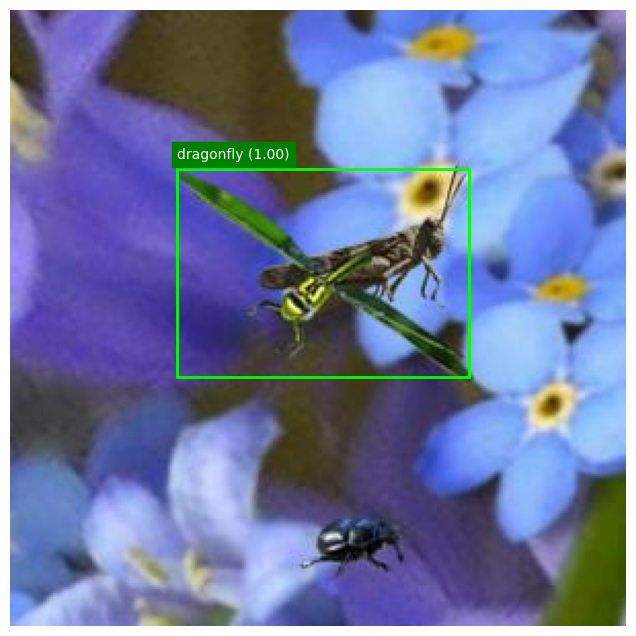

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


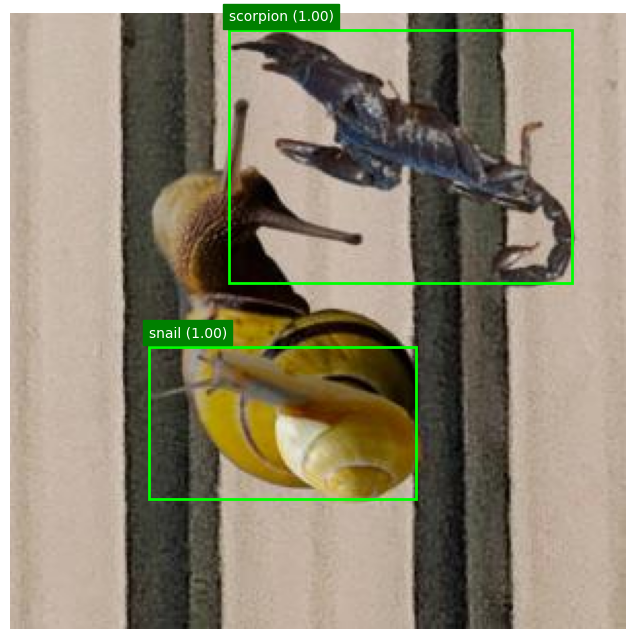

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


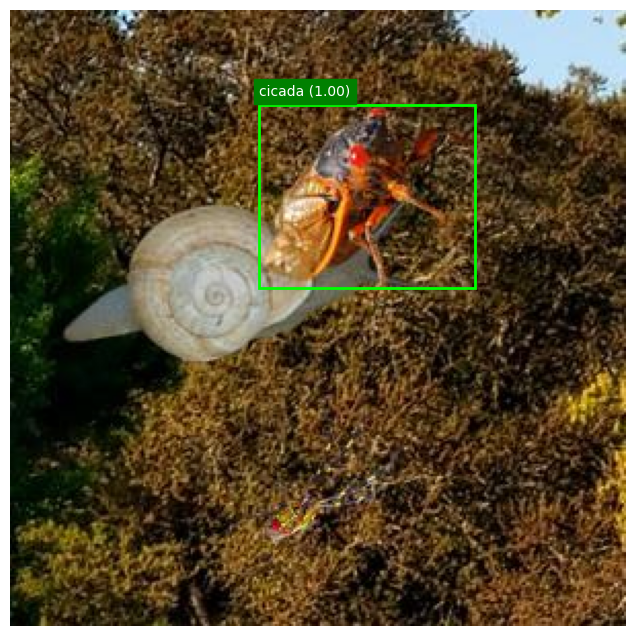

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


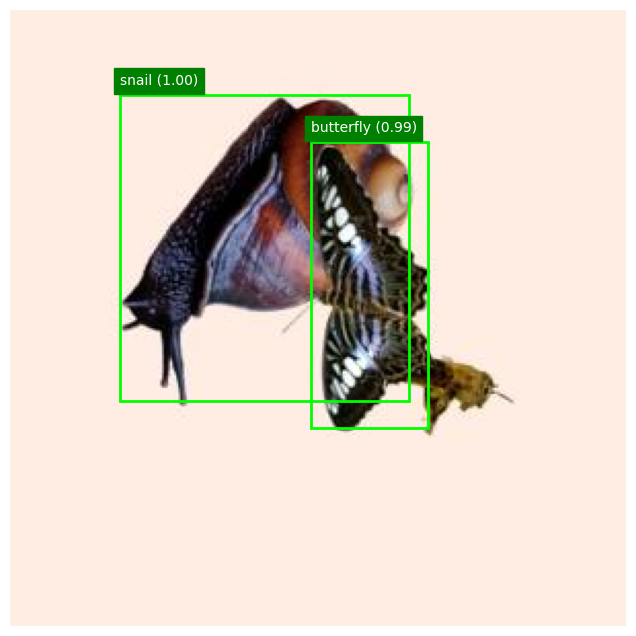

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


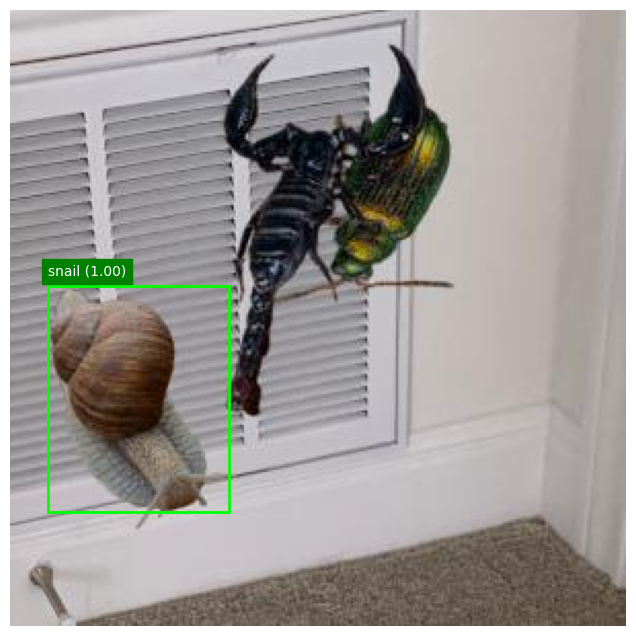

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


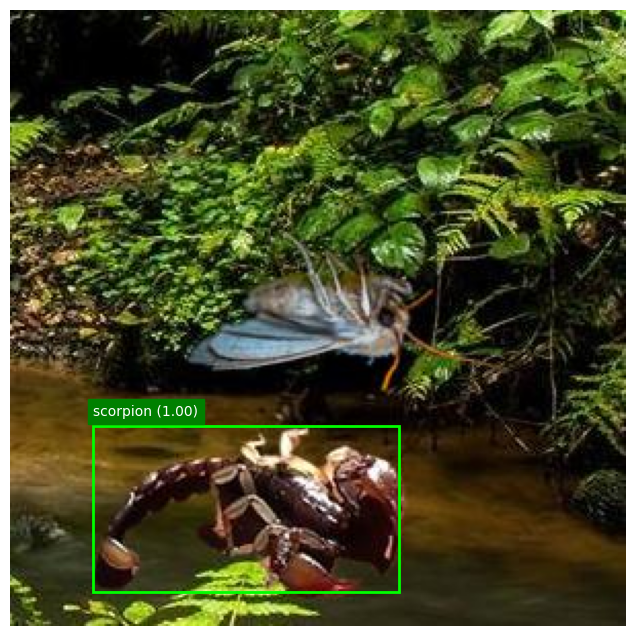

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


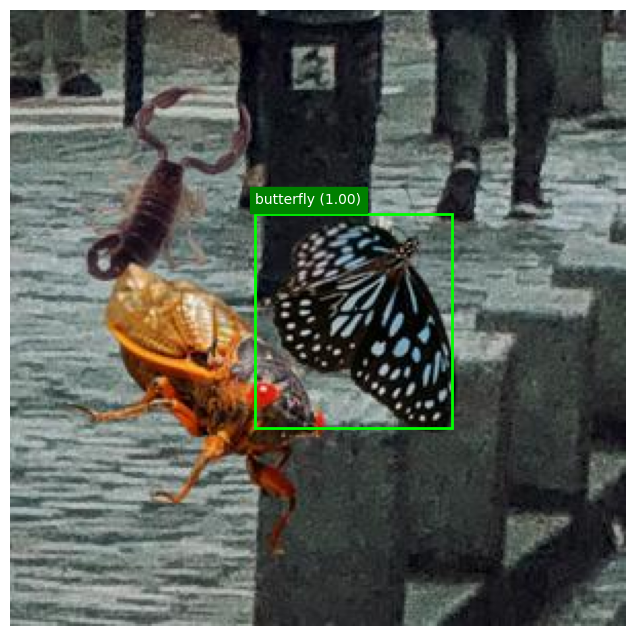

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


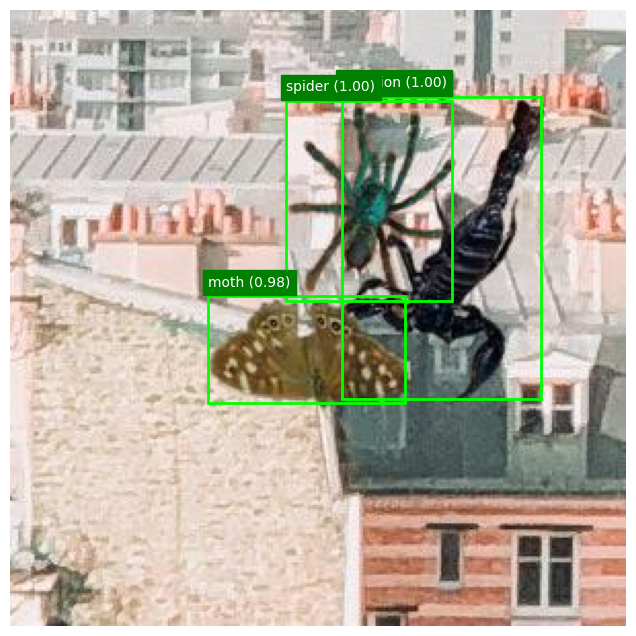

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


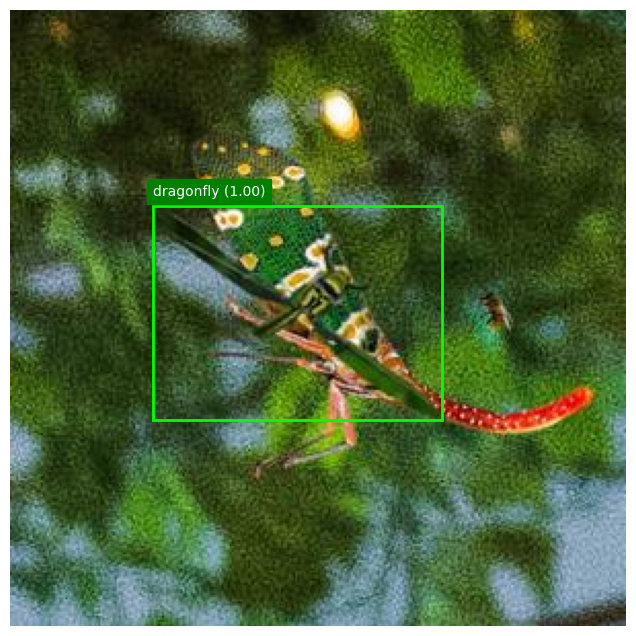

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


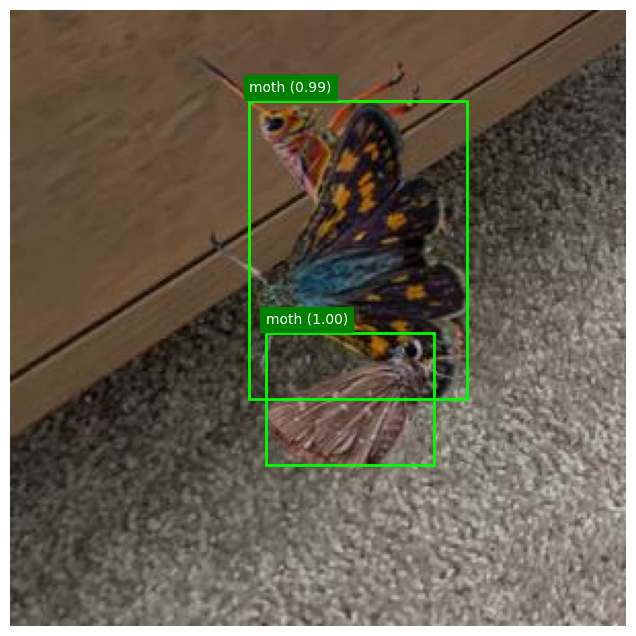

In [ ]:
#CELL 6: Segment, Crop, Predict & Visualize All Insects per Image
def classify_insects_in_image(img_data):
    file_path = os.path.join(IMAGES_DIR, img_data['file_name'])
    img = Image.open(file_path).convert("RGB")
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(img)

    for ann in img_data['annotations']:
        if not (is_large_enough(ann) and is_connected_segmentation(ann['segmentation'], ann['bbox'])):
            continue

        mask = Image.new('L', img.size, 0)
        draw = ImageDraw.Draw(mask)
        for seg in ann['segmentation']:
            polygon = [(seg[i], seg[i+1]) for i in range(0, len(seg), 2)]
            draw.polygon(polygon, fill=255)

        masked = Image.new('RGB', img.size)
        masked.paste(img, mask=mask)

        x, y, w, h = map(int, ann['bbox'])
        cropped = masked.crop((x, y, x + w, y + h)).resize(IMG_SIZE)
        input_tensor = np.expand_dims(np.array(cropped) / 255.0, axis=0)

        prediction = model.predict(input_tensor)[0]
        predicted_class = CLASS_NAMES[np.argmax(prediction)]
        confidence = np.max(prediction)

        # Draw box and label
        rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='lime', facecolor='none')
        ax.add_patch(rect)
        ax.text(x, y - 5, f"{predicted_class} ({confidence:.2f})", color='white',
                backgroundcolor='green', fontsize=10)

    ax.axis('off')
    plt.show()

# Run on random images
for key in filtered_images.keys():
    if filtered_images[key]:
        classify_insects_in_image(random.choice(filtered_images[key]))


In [ ]:
#ok now we are getting on track... soem images are being indetified accurately and since some are missing we need to make our
# model more strong so gpt suggested me this
#If you're already using segmentation (COCO), you could try Mask R-CNN which does both segmentation and classification.
#now below i am doing this .

# for this i nedded to Split your dataset into training and validation sets (e.g., 80-20 split).

#Create new COCO-format JSON files: instances_train.json and instances_val.json.

#Copy images into corresponding train/ and val/ folders.
# so below i have also done that


In [ ]:
#working on R-CNN CELL 1:
import os

base_dir = '/content/ImageClassesCombinedWithCOCOAnnotations'
os.makedirs(f'{base_dir}/annotations', exist_ok=True)
os.makedirs(f'{base_dir}/train', exist_ok=True)
os.makedirs(f'{base_dir}/val', exist_ok=True)


In [ ]:
#CELL:2 Load and Split COCO Annotations
import json
import random
from shutil import copy2

with open(f'{base_dir}/coco_instances.json') as f:
    coco_data = json.load(f)

# Get unique image IDs and shuffle
image_ids = list({img['id'] for img in coco_data['images']})
random.shuffle(image_ids)

split_index = int(0.8 * len(image_ids))
train_ids = set(image_ids[:split_index])
val_ids = set(image_ids[split_index:])

def split_annotations(coco_data, image_id_subset):
    images = [img for img in coco_data['images'] if img['id'] in image_id_subset]
    annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] in image_id_subset]
    return {
        "images": images,
        "annotations": annotations,
        "categories": coco_data['categories']
    }

train_data = split_annotations(coco_data, train_ids)
val_data = split_annotations(coco_data, val_ids)


In [ ]:
#CELL 3: Save Train/Val JSON Files
with open(f'{base_dir}/annotations/instances_train.json', 'w') as f:
    json.dump(train_data, f)

with open(f'{base_dir}/annotations/instances_val.json', 'w') as f:
    json.dump(val_data, f)


In [ ]:
#CELL 4:  Step 4: Move Images
image_map = {img['id']: img['file_name'] for img in coco_data['images']}

for img_id in train_ids:
    src = os.path.join(base_dir, 'images_raw', image_map[img_id])
    dst = os.path.join(base_dir, 'train', image_map[img_id])
    copy2(src, dst)

for img_id in val_ids:
    src = os.path.join(base_dir, 'images_raw', image_map[img_id])
    dst = os.path.join(base_dir, 'val', image_map[img_id])
    copy2(src, dst)


In [ ]:
# NOW THE FOLDER STRUCTURE THAT GPT SUGGESTED IS COMPLETED
#MOVING ONTO MAKING AND WORKING WITH MODEL


In [ ]:
#ACTUAL WORK STARTS HERE
#Cell 1: Install & Import Required Packages
# Install Detectron2
!pip install -q torch torchvision torchaudio
!pip install -q opencv-python-headless
!pip install -q git+https://github.com/facebookresearch/detectron2.git

# Imports
import os
import cv2
import random
import torch
import numpy as np
import json
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 69.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.8 MB/s eta 0:00:00
ERROR: Operation cancelled by user
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: -7
  ╰─> See above for output.
  
  note: This error or

ModuleNotFoundError: No module named 'detectron2'

In [ ]:
from detectron2.data.datasets import register_coco_instances
import os

# Set paths to your dataset directories
TRAIN_DIR = "/content/ImageClassesCombinedWithCOCOAnnotations/train"
VAL_DIR = "/content/ImageClassesCombinedWithCOCOAnnotations/val"

# Register your COCO-format datasets
register_coco_instances("instances_train.json", {}, os.path.join(TRAIN_DIR, "coco_instances.json"), os.path.join(TRAIN_DIR, "images"))
register_coco_instances("instances_val", {}, os.path.join(VAL_DIR, "coco_instances.json"), os.path.join(VAL_DIR, "images"))


In [ ]:
from detectron2.config import get_cfg
from detectron2 import model_zoo
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("insects_train",)
cfg.DATASETS.TEST = ("insects_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.OUTPUT_DIR = "/content/insect_model_output"
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000  # increase if needed
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10 # REPLACE with number of classes
cfg.MODEL.DEVICE = "cpu"  # Force CPU usage
# Output directory for training logs and checkpoints
cfg.OUTPUT_DIR = "./output"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Threshold for testing (adjust as needed)
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)


In [ ]:
from detectron2.data.datasets import register_coco_instances
import os

# Set paths to your dataset directories
TRAIN_DIR = "/content/ImageClassesCombinedWithCOCOAnnotations/train"
VAL_DIR = "/content/ImageClassesCombinedWithCOCOAnnotations/val"

# Register your COCO-format datasets
register_coco_instances("insects_train", {}, os.path.join(TRAIN_DIR, "coco_instances.json"), os.path.join(TRAIN_DIR, "images"))
register_coco_instances("insects_val", {}, os.path.join(VAL_DIR, "coco_instances.json"), os.path.join(VAL_DIR, "images"))



In [ ]:
#cell 5 :Cell 5: Train the Model
from detectron2.engine import DefaultTrainer

# Create a trainer object
trainer = DefaultTrainer(cfg)
trainer.build_train_loader = lambda: detectron2.data.build_detection_train_loader(cfg)

# Train the model
trainer.train()



[05/04 23:38:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

FileNotFoundError: Caught FileNotFoundError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/_utils/worker.py", line 349, in _worker_loop
    data = fetcher.fetch(index)  # type: ignore[possibly-undefined]
           ^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/_utils/fetch.py", line 33, in fetch
    data.append(next(self.dataset_iter))
                ^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/common.py", line 296, in __iter__
    yield self.dataset[idx]
          ~~~~~~~~~~~~^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/common.py", line 125, in __getitem__
    data = self._map_func(self._dataset[cur_idx])
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/utils/serialize.py", line 26, in __call__
    return self._obj(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/dataset_mapper.py", line 154, in __call__
    image = utils.read_image(dataset_dict["file_name"], format=self.image_format)
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/detection_utils.py", line 180, in read_image
    with PathManager.open(file_name, "rb") as f:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/iopath/common/file_io.py", line 1012, in open
    bret = handler._open(path, mode, buffering=buffering, **kwargs)  # type: ignore
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/iopath/common/file_io.py", line 604, in _open
    return open(  # type: ignore
           ^^^^^^^^^^^^^^^^^^^^^
FileNotFoundError: [Errno 2] No such file or directory: '/content/ImageClassesCombinedWithCOCOAnnotations/train/images/00001371.jpg'


In [ ]:
 #Cell 6: Evaluate Model on Validation Set
evaluator = COCOEvaluator("insects_val", cfg, False, output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "insects_val")
inference_on_dataset(trainer.model, val_loader, evaluator)


WARNING [05/04 23:46:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/04 23:46:49 d2.data.datasets.coco]: Loading /content/ImageClassesCombinedWithCOCOAnnotations/val/coco_instances.json takes 1.86 seconds.
[05/04 23:46:49 d2.data.datasets.coco]: Loaded 15000 images in COCO format from /content/ImageClassesCombinedWithCOCOAnnotations/val/coco_instances.json
[05/04 23:46:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/04 23:46:50 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/04 23:46:50 d2.data.common]: Serializing 15000 elements to byte tensors and concatenating them all ...
[05/04 23:46:50 d2.data.common]: Serialized dataset takes 34.20 MiB
[05/04 23:46:50 d2.evaluation.evaluator]: Start inference on 150

FileNotFoundError: Caught FileNotFoundError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/_utils/worker.py", line 349, in _worker_loop
    data = fetcher.fetch(index)  # type: ignore[possibly-undefined]
           ^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/_utils/fetch.py", line 52, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/_utils/fetch.py", line 52, in <listcomp>
    data = [self.dataset[idx] for idx in possibly_batched_index]
            ~~~~~~~~~~~~^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/common.py", line 125, in __getitem__
    data = self._map_func(self._dataset[cur_idx])
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/utils/serialize.py", line 26, in __call__
    return self._obj(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/dataset_mapper.py", line 154, in __call__
    image = utils.read_image(dataset_dict["file_name"], format=self.image_format)
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/detectron2/data/detection_utils.py", line 180, in read_image
    with PathManager.open(file_name, "rb") as f:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/iopath/common/file_io.py", line 1012, in open
    bret = handler._open(path, mode, buffering=buffering, **kwargs)  # type: ignore
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/iopath/common/file_io.py", line 604, in _open
    return open(  # type: ignore
           ^^^^^^^^^^^^^^^^^^^^^
FileNotFoundError: [Errno 2] No such file or directory: '/content/ImageClassesCombinedWithCOCOAnnotations/val/images/00000000.jpg'


In [ ]:
# cell 7 : interfence with new image
predictor = DefaultPredictor(cfg)

# Test on a validation image
from google.colab.patches import cv2_imshow
image_path = random.choice(dataset_dicts)["file_name"]
im = cv2.imread(image_path)
outputs = predictor(im)

v = Visualizer(im[:, :, ::-1], metadata=insects_metadata, scale=0.8)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])


In [ ]:
https://www.kaggle.com/code/abdallahwagih/insect-village-classification-acc-98?kernelSessionId=120077303

SyntaxError: invalid syntax (<ipython-input-48-1531ad51c9b5>, line 1)